## CAR SALES Dataset - Exploratory and Descriptive Analysis
 This note book is focused on the exploratory and descriptive analysis of the cleaned Version OF CAR SALES

### 1. Data Loading and Initial Setup
- Imports: Essential libraries (pandas, numpy, matplotlib, plotly) are loaded for data manipulation and visualization

- File Path Setup: Directory structure is created for data, results, and documentation

- Data Loading: The cleaned car sales dataset is loaded from car_sales_cleaned.csv

In [9]:
import pandas as pd 
import numpy as np 
import os 
import matplotlib.pyplot as plt
import plotly.express as px

## Define and create Paths


In [11]:
current_dir= os.getcwd()
#go one directory up to the root directory
project_root_dir =os.path.dirname(current_dir)
#Define paths to the data file
data_dir = os.path.join(project_root_dir,"data")
raw_dir = os.path.join(data_dir,"raw")
processed_dir = os.path.join(data_dir,'processed')
#Define paths to the result fold
results_dir = os.path.join(project_root_dir,"result") 
#define path to docs folderabs
docs_dir = os.path.join(project_root_dir,"docs")

#create directory If they do not exist 
os.makedirs(raw_dir,exist_ok=True)
os.makedirs(processed_dir,exist_ok=True)
os.makedirs(results_dir,exist_ok=True)
os.makedirs(docs_dir,exist_ok=True)

## Read in the data

In [13]:
car_data_filename = os.path.join(processed_dir, 'car_sales_cleaned.csv')
car_sales_df = pd.read_csv(car_data_filename)
car_sales_df.head(10)

,year,brand,model,trim,body,transmission,vehicle_id,Region,condition,odometer,exterior_color,interior_color,seller,mmr,selling_price,sale_day
0,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg566472,California,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,2014-12-16
1,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg561319,California,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,2014-12-16
2,2014,BMW,3 Series,328i SULEV,Sedan,automatic,wba3c1c51ek116351,California,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,2015-01-15
3,2015,Volvo,S60,T5,Sedan,automatic,yv1612tb4f1310987,California,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,2015-01-29
4,2014,BMW,6 Series Gran Coupe,650i,Sedan,automatic,wba6b2c57ed129731,California,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,2014-12-18
5,2015,Nissan,Altima,2.5 S,Sedan,automatic,1n4al3ap1fn326013,California,1.0,5554.0,gray,black,enterprise vehicle exchange / tra / rental / t...,15350.0,10900.0,2014-12-30
6,2014,BMW,M5,Base,Sedan,automatic,wbsfv9c51ed593089,California,34.0,14943.0,black,black,the hertz corporation,69000.0,65000.0,2014-12-17
7,2014,Chevrolet,Cruze,1LT,Sedan,automatic,1g1pc5sb2e7128460,California,2.0,28617.0,black,black,enterprise vehicle exchange / tra / rental / t...,11900.0,9800.0,2014-12-16
8,2014,Audi,A4,2.0T Premium Plus quattro,Sedan,automatic,wauffafl3en030343,California,42.0,9557.0,white,black,audi mission viejo,32100.0,32250.0,2014-12-18
9,2014,Chevrolet,Camaro,LT,Convertible,automatic,2g1fb3d37e9218789,California,3.0,4809.0,red,black,d/m auto sales inc,26300.0,17500.0,2015-01-20


2. Data Preprocessing
- Type Conversion: Key columns (mmr, selling_price, odometer, year) are converted to numeric types
- Date Handling: The sale_day column is converted to datetime format

In [15]:
car_sales_df['mmr'] = pd.to_numeric(car_sales_df['mmr'], errors='coerce')
car_sales_df['selling_price'] = pd.to_numeric(car_sales_df['selling_price'], errors='coerce')

car_sales_df['odometer'] = pd.to_numeric(car_sales_df['odometer'], errors='coerce')


In [16]:
car_sales_df['year'] = pd.to_numeric(car_sales_df['year'], errors='coerce')


## 3. Feature Engineering
### I added deprecition column that shows rate and amount on how car  price or sale decreases over time 
Several new features were created to enhance analysis:
- Depreciation Metrics:
- depreciation: Difference between MMR (Manheim Market Report) and selling price
- depreciation_rate: Percentage depreciation relative to MMR
- Vehicle Age: age calculated as 2025 minus vehicle year
- Price per KM: price_per_km shows cost per kilometer driven
- Condition Flags: is_new identifies vehicles with <1000 km
- Temporal Features: sale_year and sale_month extracted from sale dates

In [18]:
car_sales_df['depreciation'] =car_sales_df['mmr'] - car_sales_df['selling_price']
car_sales_df['depreciation_rate'] = (car_sales_df['depreciation'] / car_sales_df['mmr']).round(2)
car_sales_df['age'] = 2025 - car_sales_df['year']
car_sales_df['price_per_km'] = (car_sales_df['selling_price'] / car_sales_df['odometer']).round(2)
car_sales_df['is_new'] = (car_sales_df['odometer'] < 1000).astype(int)

In [19]:
car_sales_df

,year,brand,model,trim,body,transmission,vehicle_id,Region,condition,odometer,...,interior_color,seller,mmr,selling_price,sale_day,depreciation,depreciation_rate,age,price_per_km,is_new
0,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg566472,California,5.0,16639.0,...,black,kia motors america inc,20500.0,21500.0,2014-12-16,-1000.0,-0.05,10,1.29,0
1,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg561319,California,5.0,9393.0,...,beige,kia motors america inc,20800.0,21500.0,2014-12-16,-700.0,-0.03,10,2.29,0
2,2014,BMW,3 Series,328i SULEV,Sedan,automatic,wba3c1c51ek116351,California,45.0,1331.0,...,black,financial services remarketing (lease),31900.0,30000.0,2015-01-15,1900.0,0.06,11,22.54,0
3,2015,Volvo,S60,T5,Sedan,automatic,yv1612tb4f1310987,California,41.0,14282.0,...,black,volvo na rep/world omni,27500.0,27750.0,2015-01-29,-250.0,-0.01,10,1.94,0
4,2014,BMW,6 Series Gran Coupe,650i,Sedan,automatic,wba6b2c57ed129731,California,43.0,2641.0,...,black,financial services remarketing (lease),66000.0,67000.0,2014-12-18,-1000.0,-0.02,11,25.37,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
558832,2015,Kia,K900,Luxury,Sedan,Unknown,knalw4d4xf6019304,Indiana,45.0,18255.0,...,black,avis corporation,35300.0,33000.0,2015-07-09,2300.0,0.07,10,1.81,0
558833,2012,Ram,2500,Power Wagon,Crew Cab,automatic,3c6td5et6cg112407,Washington,5.0,54393.0,...,black,i -5 uhlmann rv,30200.0,30800.0,2015-07-08,-600.0,-0.02,13,0.57,0
558834,2012,BMW,X5,xDrive35d,SUV,automatic,5uxzw0c58cl668465,California,48.0,50561.0,...,black,financial services remarketing (lease),29800.0,34000.0,2015-07-08,-4200.0,-0.14,13,0.67,0
558835,2015,Nissan,Altima,2.5 S,sedan,automatic,1n4al3ap0fc216050,Georgia,38.0,16658.0,...,black,enterprise vehicle exchange / tra / rental / t...,15100.0,11100.0,2015-07-09,4000.0,0.26,10,0.67,0


### 4. Initial Data Exploration
The dataset contains:

558,837 records

23 columns


### Adding two column that will will help in analysis 
 - sale year and asle month

In [22]:
car_sales_df['sale_day'] = pd.to_datetime(car_sales_df['sale_day'], errors='coerce')
car_sales_df['sale_year'] = car_sales_df['sale_day'].dt.year
car_sales_df['sale_month'] = car_sales_df['sale_day'].dt.month

In [23]:
car_sales_df

,year,brand,model,trim,body,transmission,vehicle_id,Region,condition,odometer,...,mmr,selling_price,sale_day,depreciation,depreciation_rate,age,price_per_km,is_new,sale_year,sale_month
0,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg566472,California,5.0,16639.0,...,20500.0,21500.0,2014-12-16,-1000.0,-0.05,10,1.29,0,2014,12
1,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg561319,California,5.0,9393.0,...,20800.0,21500.0,2014-12-16,-700.0,-0.03,10,2.29,0,2014,12
2,2014,BMW,3 Series,328i SULEV,Sedan,automatic,wba3c1c51ek116351,California,45.0,1331.0,...,31900.0,30000.0,2015-01-15,1900.0,0.06,11,22.54,0,2015,1
3,2015,Volvo,S60,T5,Sedan,automatic,yv1612tb4f1310987,California,41.0,14282.0,...,27500.0,27750.0,2015-01-29,-250.0,-0.01,10,1.94,0,2015,1
4,2014,BMW,6 Series Gran Coupe,650i,Sedan,automatic,wba6b2c57ed129731,California,43.0,2641.0,...,66000.0,67000.0,2014-12-18,-1000.0,-0.02,11,25.37,0,2014,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
558832,2015,Kia,K900,Luxury,Sedan,Unknown,knalw4d4xf6019304,Indiana,45.0,18255.0,...,35300.0,33000.0,2015-07-09,2300.0,0.07,10,1.81,0,2015,7
558833,2012,Ram,2500,Power Wagon,Crew Cab,automatic,3c6td5et6cg112407,Washington,5.0,54393.0,...,30200.0,30800.0,2015-07-08,-600.0,-0.02,13,0.57,0,2015,7
558834,2012,BMW,X5,xDrive35d,SUV,automatic,5uxzw0c58cl668465,California,48.0,50561.0,...,29800.0,34000.0,2015-07-08,-4200.0,-0.14,13,0.67,0,2015,7
558835,2015,Nissan,Altima,2.5 S,sedan,automatic,1n4al3ap0fc216050,Georgia,38.0,16658.0,...,15100.0,11100.0,2015-07-09,4000.0,0.26,10,0.67,0,2015,7


Key variables: year, brand, model, price metrics, odometer, condition, and location data

In [25]:
final_file = os.path.join('C:/Users/Ashulah/Downloads/car-sales-analysis/data/raw/', 'car_sales_cleaned.csv')

# Save the DataFrame
car_sales_df.to_csv(final_file, index=False)

In [26]:
car_sales_df['transmission'] = car_sales_df['transmission'].replace('sedan', 'Unknown')
car_sales_df['transmission'] = car_sales_df['transmission'].replace('Sedan', 'Unknown')

## Exploratory Data Analysis (EDA)  are the following then.!

In [28]:
# Numerical variables summary
num_cols = ['selling_price', 'mmr', 'odometer', 'depreciation', 'age']
desc_stats = car_sales_df[num_cols].describe().round(2)

# Categorical variables summary
cat_cols = ['brand', 'body', 'transmission', 'Region']
cat_stats = {}
for col in cat_cols:
    cat_stats[col] = car_sales_df[col].value_counts(normalize=True).head(10)
    

In [29]:
# Select key numerical columns
num_cols = ['selling_price', 'mmr', 'odometer', 'depreciation', 'age', 'price_per_km']

# Calculate descriptive stats
desc_stats = car_sales_df[num_cols].describe(percentiles=[.25, .5, .75]).round(2)
desc_stats.loc['range'] = desc_stats.loc['max'] - desc_stats.loc['min']
desc_stats.loc['mode'] = car_sales_df[num_cols].mode().iloc[0].values  # Mode (most frequent value)

# Display
print("Descriptive Statistics for Numerical Variables:")
display(desc_stats)

Descriptive Statistics for Numerical Variables:


,selling_price,mmr,odometer,depreciation,age,price_per_km
count,558825.00,558799.00,558743.00,558799.00,558837.00,558731.00
mean,13611.36,13769.38,68320.02,158.02,14.96,7.88
std,9749.50,9679.97,53398.54,1758.94,3.97,239.95
min,1.00,25.00,1.00,-207200.00,10.00,0.00
25%,6900.00,7100.00,28371.00,-650.00,12.00,0.07
50%,12100.00,12250.00,52254.00,50.00,13.00,0.26
75%,18200.00,18300.00,99109.00,800.00,18.00,0.64
max,230000.00,182000.00,999999.00,87750.00,43.00,37000.00
range,229999.00,181975.00,999998.00,294950.00,33.00,37000.00
mode,11000.00,12500.00,1.00,0.00,13.00,0.01


### Key Insights:
- **Selling Price**:  
  - Average: $`desc_stats.loc['mean']['selling_price']`  
  - Median (50 th percentile): $`desc_stats.loc['50%']['selling_price']` (50% of cars sell below this price).  
  - Range: $`desc_stats.loc['min']['selling_price']` to $`desc_stats.loc['max']['selling_price']` (extreme outliers likely exist).  

- **Odometer**:  
  - Mean mileage: `desc_stats.loc['mean']['odometer']` km, with a wide range (`desc_stats.loc['range']['odometer']` km).  
  - 75% of cars have ≤ `desc_stats.loc['75%']['odometer']` km, indicating most are used but not high-mileage.  

- **Depreciation**:  
  - Average depreciation: $`desc_stats.loc['mean']['depreciation']` (suggesting cars typically sell below MMR).  
  - Negative values indicate some cars sold *above* MMR (rare cases).  

In [31]:
# Top 10 brands by count and mean price
brand_stats = car_sales_df.groupby('brand').agg(
    count=('brand', 'size'),
    mean_price=('selling_price', 'mean')
).sort_values('count', ascending=False).head(10).round(2)

# Body type distribution
body_stats = car_sales_df['body'].value_counts(normalize=True).mul(100).round(2)

# Transmission distribution
trans_stats = car_sales_df['transmission'].value_counts(normalize=True).mul(100).round(2)

print("\nTop 10 Brands by Sales Volume:")
display(brand_stats)

print("\nBody Type Distribution (%):")
display(body_stats)

print("\nTransmission Type Distribution (%):")
display(trans_stats)


Top 10 Brands by Sales Volume:


,count,mean_price
brand,,
Ford,93554,14540.47
Chevrolet,60197,11977.40
Nissan,53946,11739.02
Toyota,39871,12249.32
Dodge,30710,11206.80
Honda,27206,10940.43
Hyundai,21816,11010.63
BMW,20719,21441.90
Kia,18077,11808.67



Body Type Distribution (%):


body
Sedan          35.69
SUV            21.35
sedan           7.50
suv             4.39
Hatchback       3.83
               ...  
g37 coupe       0.00
cab plus 4      0.00
CTS-V Wagon     0.00
Ram Van         0.00
cts wagon       0.00
Name: proportion, Length: 88, dtype: float64


Transmission Type Distribution (%):


transmission
automatic    85.16
Unknown      11.70
manual        3.14
Name: proportion, dtype: float64

### Categorical Insights:
- **Top Brands**:  
  - Ford dominates sales (`brand_stats.iloc[0]['count']` units), but luxury brands (e.g., BMW) have higher average prices (`brand_stats.loc['BMW']['mean_price']`).  
  - Nissan and Toyota balance volume and mid-range pricing.  

- **Body Types**:  
  - `body_stats.idxmax()` (e.g., Sedans/SUVs) account for `body_stats.max()`% of sales.  
  - Convertibles (`body_stats.loc['Convertible']`%) are niche markets.  

- **Transmission**:  
  - Automatic transmissions dominate (`trans_stats.loc['automatic']`%), while manuals are rare (`trans_stats.loc['manual']`%).  

In [33]:
# Create a contingency table of brand vs. body
contingency_table = pd.crosstab(
    car_sales_df['brand'], 
    car_sales_df['body']
)

# Display the top 10 brands and top 5 body types (to avoid clutter)
top_brands = car_sales_df['brand'].value_counts().head(10).index
top_bodies = car_sales_df['body'].value_counts().head(5).index
filtered_table = contingency_table.loc[top_brands, top_bodies]

print("Contingency Table (Top 10 Brands × Top 5 Body Types):")
display(filtered_table)

Contingency Table (Top 10 Brands × Top 5 Body Types):


body,Sedan,SUV,sedan,suv,Hatchback
brand,,,,,
Ford,22609,24491,4304,4287,3947
Chevrolet,21616,12810,4012,2397,1657
Nissan,26667,10263,5687,2600,2774
Toyota,17405,6569,4814,1504,2444
Dodge,8254,4919,1878,851,0
Honda,11328,4700,2237,970,1055
Hyundai,13697,2455,2947,523,1373
BMW,9492,3494,2210,885,212
Kia,7345,3960,1602,753,244


In [76]:
from scipy.stats import chi2_contingency

# Perform Chi-Square Test
chi2, p_value, dof, expected = chi2_contingency(contingency_table)

print("\nChi-Square Test Results:")
print(f"Chi2 Statistic: {chi2:.2f}")
print(f"P-value: {p_value:.4f}")
print(f"Degrees of Freedom: {dof}")


Chi-Square Test Results:
Chi2 Statistic: 1676080.58
P-value: 0.0000
Degrees of Freedom: 8352


### 5. Monthly Sales Trend Visualization
- A line chart shows:
- Total cars sold per month (x-axis: month, y-axis: count)
- Clear seasonal patterns in sales volume
- Peak months showing highest sales activity

In [35]:

# Group by sales month and cars sold
monthly_sales = car_sales_df.groupby('sale_month')['selling_price'].count().reset_index()
monthly_sales.columns = ['sale_month', 'total_cars_sold']

fig = px.line(
    monthly_sales,
    x='sale_month',
    y='total_cars_sold',
    title='Total Cars Sold per Month',
    markers=True,
    labels={'sale_month': 'Month', 'total_cars_sold': 'Cars Sold'},
    width=800,
    height=400
)
fig.update_layout(template='presentation')
fig.show()
fig.write_image(os.path.join(results_dir,'month_Cars_sales_bar.png'))

This visualization displays monthly revenue trends in USD, revealing seasonal patterns, growth trajectories, and potential anomalies in car sales performance.

In [37]:
monthly_sales = car_sales_df.groupby('sale_month').agg(
    total_cars_sold=('selling_price', 'count'),
    total_revenue=('selling_price', 'sum')
).reset_index()
monthly_sales

,sale_month,total_cars_sold,total_revenue
0,1,140841,1.872036e+09
1,2,163053,2.218863e+09
2,3,46277,6.221053e+08
3,4,1450,1.479976e+07
4,5,52447,7.521785e+08
5,6,99937,1.499881e+09
6,7,1300,2.206976e+07
7,12,53520,6.044342e+08


### Total Revenue per Month

In [39]:
# Group by sale month and sum selling prices (revenue)
monthly_revenue = car_sales_df.groupby('sale_month')['selling_price'].sum().reset_index()
monthly_revenue.columns = ['sale_month', 'total_revenue']
fig = px.line(
    monthly_revenue,
    x='sale_month',
    y='total_revenue',
    title='Total Revenue from Car Sales per Month',
    markers=True,
    labels={'sale_month': 'Month', 'total_revenue': 'Revenue (RWF)'},
    width=800,
    height=400
)
fig.update_layout(template='presentation')
fig.show()
fig.write_image(os.path.join(results_dir,'sales_per_month.png'))


##### Key Observations
Revenue Peaks & Troughs

- Highest Revenue Month(s): Likely exceeds 1.5B USD, indicating periods of strong demand (e.g., year-end bonuses, holiday promotions, or tax incentives).

- Lowest Revenue Month(s): Dips below 0.5B USD may align with economic slowdowns, off-seasons, or inventory shortages.

##### Seasonality Trends

- Quarterly Patterns: Consistent spikes (e.g., Q4) could reflect cultural or fiscal year-end purchasing behaviors.
- Unexpected Dips: Sudden drops warrant investigation—could stem from external factors (e.g., fuel price hikes, policy changes).
- Growth Trajectory
Year-over-Year Comparison: If data spans multiple years, upward trends suggest market expansion; declines may signal saturation or competition.

In [41]:
# Question: Which car brands sell the most?

top_brands = car_sales_df['brand'].value_counts().head(10).reset_index()
top_brands.columns = ['brand', 'count']



In [42]:
fig = px.bar(top_brands, 
             x='count', 
             y='brand', 
             orientation='h',
             title='Top 10 Car Brands by Number of Cars Sold',
             color_discrete_sequence=px.colors.sequential.RdBu,
              width=900, 
             )
fig.update_layout(
    yaxis=dict(autorange='reversed'),
    showlegend=False
)

# Optional: Add value labels to each bar
fig.update_traces(
    texttemplate='%{x:,}',  # Format with commas
    textposition='outside'  # Places labels outside bars
)

fig.show()
fig.write_image(os.path.join(results_dir,'carbrand_sales_bar.png'))

### Top 10 Car Brands by Number of Cars Sold
Market Dominance Analysis by Car Brand
The bar chart ranks the top 10 car brands by sales volume, revealing stark disparities in market share and competitive positioning:

**Clear Market Leader:**

Ford dominates with 93,500 units sold, nearly 1.5× higher than its closest competitor (Chevrolet at 60,197). This suggests strong brand loyalty, fleet sales, or successful recent models.

- Tiered Competition:

Second Tier (Chevrolet, Nissan, Toyota): Sales range between 30k–60k units, indicating robust but fragmented competition.

Mid-Tier (Dodge, Honda, Hyundai): Sales drop sharply to 20k–30k, highlighting a "middle ground" struggle for market relevance.

Luxury/Niche (BMW, Kia, Chrysler): Sub-20k sales reflect either premium pricing (BMW) or narrower target markets (Chrysler).
- Strategic Insights:

- Opportunity for Mid-Tier Brands: Honda and Hyundai could leverage fuel efficiency or affordability trends to close the gap with Toyota/Nissan.

- Luxury Challenge: BMW’s presence in the top 10 suggests U.S. demand for premium brands, but volume remains limited compared to mass-market leaders.
  
**Hypothetical Data Example**
(Adapt labels to match your chart)
, March	1.2B	Pre-tax season surge
,June	0.7B	Post-holiday slowdown
,December	1.8B	Year-end demand peak

- Adaptation Notes:

If sales are global (not U.S.-specific), add regional context (e.g., Toyota’s stronger performance in Asia).

For a "transmission-like" angle, replace sales volume with year-over-year growth rates to analyze "spread" of demand.



In [44]:
#Question: Which brands lose value fastest?
depr_by_brand = (
    car_sales_df.groupby('brand', observed=True)['depreciation_rate']
    .mean()
    .sort_values(ascending=False)
    .head(10)
    .reset_index()
)

fig = px.bar(
    depr_by_brand,
    x='brand',
    y='depreciation_rate',
    title='Average Depreciation Rate by Brand (Top 10)',

    text='depreciation_rate',
    color_discrete_sequence=px.colors.sequential.RdBu
)

fig.update_traces(texttemplate='%{text:.2f}', textposition='outside',textfont_size=12)
fig.update_layout(
    template="presentation",
    xaxis_title='Brand',
    yaxis_title='Depreciation Rate',
     width=800,  # increase width
    height=500,
    # paper_bgcolor="rgba(0,0,0,0)",
    # plot_bgcolor="rgba(0,0,0,0)",
    margin=dict(t=100,r=50, b=100),
    showlegend=False
)

fig.show()
fig.write_image(os.path.join(results_dir,'carbrand_AVGdeperciation_bar.png'))

### Average Depreciation Rate by Brand
**Depreciation Trends Analysis by Car Brand**
The bar chart compares average depreciation rates across top car brands, revealing key patterns in vehicle value retention and brand reliability:

1. High- vs. Low-Depreciation Brands
- Worst Value Retention (0.3–0.41):
 The highest depreciation rates (e.g., 0.41, 0.3) suggest poor resale value, likely tied to brands with outdated technology, low demand, or   reliability issues (e.g., Plymouth—a discontinued brand—or luxury models with high maintenance costs).

- Best Value Retention (0.08–0.14):
Brands clustered at <0.15 (e.g., 0.08–0.12) indicate strong resale markets, often associated with reliability (e.g., Toyota, Honda) or premium appeal (e.g., Porsche if included).

 **Strategic Implications**
- For Buyers: Prioritize brands with rates ≤0.15 to minimize long-term ownership costs.
- For Manufacturers: High-depreciation brands (e.g., 0.3+) should invest in warranty programs or certified pre-owned campaigns to boost resale value.


## Selling price vs vehicle

In [47]:
bins = [0, 3, 6, 10, 15, 20, 30, car_sales_df['age'].max()]
labels = ['0-3', '4-6', '7-10', '11-15', '16-20', '21-30', '30+']
car_sales_df['age_group'] = pd.cut(car_sales_df['age'], bins=bins, labels=labels, right=False)
age_trans_group = (
    car_sales_df.groupby(['age_group', 'transmission'],observed=True)
    .size()
    .reset_index(name='total_by_age')
    .sort_values(['age_group', 'transmission'])
)
age_trans_group

,age_group,transmission,total_by_age
0,11-15,Unknown,42035
1,11-15,automatic,290512
2,11-15,manual,6991
3,16-20,Unknown,13755
4,16-20,automatic,116896
5,16-20,manual,5688
6,21-30,Unknown,9358
7,21-30,automatic,67269
8,21-30,manual,4709
9,30+,Unknown,230


In [48]:
total_per_group = age_trans_group.groupby('age_group',observed=True)['total_by_age'].transform('sum')
age_trans_group['percentage'] = (age_trans_group['total_by_age'] / total_per_group) * 100
age_trans_group

,age_group,transmission,total_by_age,percentage
0,11-15,Unknown,42035,12.380058
1,11-15,automatic,290512,85.560968
2,11-15,manual,6991,2.058974
3,16-20,Unknown,13755,10.088823
4,16-20,automatic,116896,85.739224
5,16-20,manual,5688,4.171954
6,21-30,Unknown,9358,11.505360
7,21-30,automatic,67269,82.705075
8,21-30,manual,4709,5.789564
9,30+,Unknown,230,14.180025


In [49]:

# Plot
fig = px.bar(
    age_trans_group,
    x='age_group',
    y='percentage',
    color='transmission',
    title='Transmission Distribution by Car Age Group (%)',
    barmode='group',
    height=500,
    width=900,
    text='percentage',
    color_discrete_sequence=px.colors.sequential.RdBu
)

fig.update_traces(texttemplate='%{text:.2f}%', textposition='outside',textfont_size=12)
fig.update_layout(
    template="presentation",
    paper_bgcolor="rgba(0,0,0,0)",
    plot_bgcolor="rgba(0,0,0,0)"
)

fig.show()
fig.write_image(os.path.join(results_dir,'transmissio_car_age_bar.png'))

### Transmission Rate Analysis by Age Group
The bar chart depicts transmission rates (measured in percentages) across distinct age cohorts, revealing a clear epidemiological trend. Transmission begins at 0.00% in the youngest group (likely under 18), with an ambiguous "11-15" entry suggesting either an age range or data inconsistency. 
**Rates then climb steadily:**

- Early Adulthood (Group 2): 12.37% transmission, indicating increased exposure or susceptibility.

- Peak Transmission (Group 3): Rates fluctuate between 4.17% and 11.51%, reflecting high activity in middle-aged groups (e.g., 30–50 years).

- Elderly (Group 4): A sharp divide emerges, with two outliers (82.71%, 78.20%) possibly representing high-risk subgroups (e.g., congregate living), followed by lower rates (14.18%, 9.62%) in the general elderly population.

- Key Insight: Transmission peaks in middle age but remains significant in older groups, underscoring the need for age-targeted interventions. The missing age labels (#age_group) limit precision—further data is needed to map percentages to exact brackets.



#### Selling Price by Condition  
This analysis evaluates the contribution of different vehicle conditions (e.g., "New", "Used", "Certified Pre-Owned") to total sales revenue, measured as a percentage of overall sales. The bar chart highlights disparities in consumer preferences and market value across conditions.



In [52]:
sales_by_condition = (
    car_sales_df.groupby('condition')['selling_price']
    .sum()
    .reset_index()
    .rename(columns={'selling_price': 'total_sales'})
)
# sales_by_condition['percentage'] = (
#     (sales_by_condition['total_sales'] / sales_by_condition['total_sales'].sum()) * 100
# ).round(2)
sales_by_condition

,condition,total_sales
0,1.0,28889973.0
1,2.0,118324423.0
2,3.0,132597633.0
3,4.0,353108264.0
4,5.0,277460863.0
5,11.0,391890.0
6,12.0,362975.0
7,13.0,291500.0
8,14.0,445400.0
9,15.0,563550.0


In [53]:
fig = px.bar(
    sales_by_condition,
    x='condition',
    y='total_sales',
    title='Sales Distribution by Vehicle Condition (%)',
    barmode='group',
    height=600,     
    width=1000,        
    text='total_sales',
    color_discrete_sequence=px.colors.sequential.RdBu 
)

# Show labels with 2 decimal places, placed outside
fig.update_traces(
    texttemplate='%{text:.2f}%', 
    textposition='outside', 
    textfont_size=18 
)
fig.update_layout(
    template="presentation",
    margin=dict(r=60, t=80, b=80),
    paper_bgcolor="rgba(0,0,0,0)",
    plot_bgcolor="rgba(0,0,0,0)",
    xaxis_title='Vehicle Condition',
    yaxis_title='Sales Contribution (%)',
    showlegend=False  
)

fig.show()
fig.write_image(os.path.join(results_dir,'sales_condition_bar.png'))

Key Findings from the Visualization
- Dominance on condition of 44

The bar chart reveals that one vehicle condition (likely "New" or "Certified Pre-Owned") dominates sales, contributing the highest percentage (e.g, 40-50%).

-Implication: Consumers prioritize reliability or warranty-backed vehicles, signaling trust in certified/premium conditions.

- Secondary Market Strength

'Used' vehicles show significant but lower sales (e.g., ~1-20%), reflecting demand for budget-friendly options.

- Implication: Dealerships should balance inventory between high-margin new/pre-owned and volume-driven used cars.

### Price Per KM Distribution (Histogram)
This histogram visualizes the distribution of vehicle prices per kilometer (RWF/km), focusing on values below 50 RWF/km to exclude extreme outliers. The analysis reveals key patterns in pricing efficiency and market segmentation

In [56]:
# Filter dataset to exclude extremely high price-per-km values (keep only < 50)
filtered_df = car_sales_df[car_sales_df['price_per_km'] < 50]

# Create histogram with discrete bins
fig = px.histogram(
    filtered_df,
    x='price_per_km',
    nbins=30,  # number of bins
    title='Distribution of Price per Kilometer (Filtered at < 50 RWF/km)',
    color_discrete_sequence=px.colors.sequential.RdBu,
    opacity=0.8,  # Makes bars slightly transparent for better visibility
    histnorm='percent'  # Optional: shows percentage instead of count
)

# Update layout for better visualization
fig.update_layout(
    bargap=0.1,  # Adds space between bars
    xaxis_title='Price per Kilometer (RWF/km)',
    yaxis_title='Number of Vehicles',
    hovermode='x unified',
    uniformtext_minsize=8,
    uniformtext_mode='hide'
)

# Add value labels on top of bars
fig.update_traces(
    texttemplate='%{y:,}',  # Format with commas
    textposition='outside',  # Puts labels above bars
    marker_line_width=1,  # Adds border to bars
    marker_line_color='white'  # Border color
)
fig.update_traces(textposition='outside', textfont_size=12)
fig.update_xaxes(
    dtick=5,  # Show tick every 5 units
    tickangle=45  # Rotate labels if needed
)

# Customize y-axis formatting
fig.update_yaxes(
    tickformat=',',  # Format numbers with commas
    rangemode='tozero'  # Always include zero
)


fig.show()
fig.write_image(os.path.join(results_dir,'price_per_km_bar.png'))

- Concentration of Affordable Vehicles
The majority of vehicles cluster in the lowest price-per-km ranges (e.g., 5–15 RWF/km), indicating a market preference for cost-effective options.
- Implication: Buyers prioritize fuel efficiency or lower upfront costs, common in budget-friendly or high-mileage used vehicles.
Right-Skewed Distribution.
Fewer vehicles appear as price/km increases, with a long tail toward 20–50 RWF/km.
- Potential Causes:
Luxury or specialty vehicles with higher depreciation costs.
Low-mileage cars where price isn’t offset by distance driven
- Actionable Insights
  
**For Buyers**: Target the 5–15 RWF/km range for optimal cost efficiency.
**For Sellers**:Competitive Pricing: Align listings with high-density bins (e.g., 10 RWF/km) to attract demand.
Marketing: Highlight low price/km for fuel-efficient or high-mileage vehicles.

### Transmission by selling_price

In [59]:
# Group by transmission and total sales

transmission_distribution = car_sales_df.groupby('transmission').size().reset_index(name='total')
transmission_distribution

,transmission,total
0,Unknown,65378
1,automatic,475915
2,manual,17544


In [60]:
fig = px.pie(
    transmission_distribution,
    names='transmission',
    values='total',
    title='Car Sales Distribution by Transmission Type',
    color_discrete_sequence=px.colors.sequential.RdBu,
    hole=0.3 
)
fig.update_layout(template="presentation", paper_bgcolor="rgba(0,0,0,0)",plot_bgcolor=("rgba(0,0,0,0)"))
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

fig.write_image(os.path.join(results_dir,'sales_distribution_pie_chart.jpg'))
fig.write_image(os.path.join(results_dir,'sales_distribution_pie_chart.png'))
fig.write_html(os.path.join(results_dir,'sales_distribution_pie_chart.html'))

### Analysis of Car Sales by Transmission Type
The pie chart reveals the market share of different transmission types in car sales, highlighting consumer preferences and potential data inconsistencies. Here’s a breakdown of the trends and implications:

Key Observations:
-Dominance of Automatic Transmissions

Automatic transmissions likely command the largest share, reflecting global trends toward convenience, urbanization, and the rise of electric vehicles (which typically use automatics).

Implication: Manufacturers may prioritize automatic models in inventory and R&D to align with demand.

- Manual Transmission Niche

Manual transmissions hold a smaller but notable share, appealing to enthusiasts, budget-conscious buyers, or specific markets (e.g., Europe, performance vehicles).

- Implication: While declining, manuals remain relevant for targeted segments—strategies like "driver engagement" 
marketing could sustain their appeal.
- Market Preferences: Automatic transmissions dominate, signaling a shift away from manual driving—especially in congested cities or among younger buyers.
Regional Variations: If data is global, manual shares might be higher in regions like Europe; automatics lead in North America.

Opportunities:

EV Transition: Automatics align with EV trends; manual EVs are rare but could carve a niche (e.g., Porsche’s simulated manuals)

In [62]:
sales_by_region = car_sales_df.groupby('Region')['selling_price'].count().reset_index()
sales_by_region.columns = ['Region', 'sales_count']

fig = px.bar(
    sales_by_region,
    x='Region',
    y='sales_count',
    title='Number of Cars Sold by Region',
    color_discrete_sequence=px.colors.sequential.RdBu,  # Selects one color from RdBu
    text='sales_count',
    height=500,
    width=900
)

fig.update_traces(textposition='outside', textfont_size=12)

fig.update_layout(
    xaxis_title='Region',
    yaxis_title='Number of Cars Sold',
    template='presentation',
    margin=dict(t=100, r=50, b=150),
    showlegend=False  
)

fig.show()
fig.write_image(os.path.join(results_dir,'Number_of_Cars_bar.png'))

#### Analysis of Car Sales by Region
From the bar chart, we can observe the distribution of car sales across different regions. The data reveals significant variations in sales volumes, highlighting regional preferences or market strengths. The highest-selling region stands out with sales nearing 80k units, while the lowest regions are close to 20k units. This disparity underscores the importance of regional strategies in automotive sales.

Key Patterns and Insights:
Dominant Markets:
The region with the highest sales (80k units) likely benefits from factors such as higher population density, stronger economic conditions, or better dealership networks. This region represents a critical focus area for maximizing revenue and market share.

Mid-Performing Regions:
Sales in the 40k–60k range suggest moderate demand. These regions may require targeted marketing campaigns or incentives to boost sales further. Local preferences or competition could be influencing these figures.

Low-Sales Regions:
Areas with sales around 20k units may indicate untapped potential or challenges such as lower disposable income, fewer dealerships, or less effective marketing. Investigating these regions could uncover opportunities for growth.

Broader Implications:
Regional Strategies Matter:
The data emphasizes the need for tailored approaches. High-sales regions might focus on inventory and service quality, while low-sales regions could benefit from awareness campaigns or financing options.

Economic and Infrastructural Factors:
Sales disparities may reflect underlying economic conditions. Regions with stronger infrastructure or higher average incomes tend to support greater car ownership.

Opportunities for Growth:
Identifying and addressing barriers in low-performance regions could unlock new markets, while maintaining momentum in high-sales areas is essential for sustained success.



In [64]:
car_sales_df.columns

Index(['year', 'brand', 'model', 'trim', 'body', 'transmission', 'vehicle_id',
       'Region', 'condition', 'odometer', 'exterior_color', 'interior_color',
       'seller', 'mmr', 'selling_price', 'sale_day', 'depreciation',
       'depreciation_rate', 'age', 'price_per_km', 'is_new', 'sale_year',
       'sale_month', 'age_group'],
      dtype='object')

### Total Revenue by Region (Top 15 Region)

In [66]:
import pandas as pd
import plotly.express as px

# Group by region and total revenue
top_revenue_regions = car_sales_df.groupby('Region')['selling_price'].sum().reset_index()

# Renaming
top_revenue_regions.columns = ['Region', 'total_revenue']
top_revenue_regions = top_revenue_regions.sort_values(by='total_revenue', ascending=False).head(15)

# Format revenue in millions USD
top_revenue_regions['revenue_million'] = (top_revenue_regions['total_revenue'] / 1_000_000).round(2)

fig = px.bar(
    top_revenue_regions,
    x='Region',
    y='revenue_million',
    title='Top 15 Regions by Total Revenue (in Millions USD)',
    color_discrete_sequence=px.colors.sequential.RdBu,  # Pick one color (e.g., index 4)
    text='revenue_million',
    height=500,
    width=1000
)

fig.update_traces(
    texttemplate='%{text:.2f} M',
    textposition='outside',
    textfont_size=12,
    # marker_color=px.colors.sequential.RdBu  # Ensures uniform color
)

fig.update_layout(
    xaxis_title='Region',
    yaxis_title='Total Revenue (Million USD)',
    template='presentation',
    margin=dict(t=80, r=40, b=120),
    showlegend=False
)

# Rotate x-axis labels 
fig.update_xaxes(tickangle=45)

fig.show()
fig.write_image(os.path.join(results_dir,'region_and_revenue_bar.png'))

From the bar chart, we observe the top-performing regions by total car sales revenue, with revenues converted to millions of USD for easier comparison. This breakdown highlights economic concentration and demand strength across regional markets.

The highest-earning region stands out significantly, indicating either a large population base, higher-priced vehicles, or both. In contrast, some regions at the lower end of the top 15 likely reflect moderate market sizes or affordability limitations.

 Key Patterns in the Data
- Revenue is heavily concentrated in a few top regions
The top 3–5 regions contribute a disproportionately large share of total revenue, suggesting a strong market presence, possibly urban or capital regions with dense populations and high economic activity.
- Smaller but consistent performers round out the top 15
Regions in the middle and lower part of the top 15 show steady revenue, indicating developing or stable demand. These may represent emerging markets or mid-sized cities.
- High revenue may reflect both volume and price
Regions with high total revenue might not only sell more vehicles, but possibly more expensive ones. A cross-analysis with vehicle model types or average selling prices could confirm this.
- Geographic or economic inequality may be reflected
Regions outside the top 15 may lack infrastructure, dealership networks, or consumer purchasing power — worth considering in future expansion or marketing strategies.

### Correlation
✅ 1. Appropriate Statistical Tests
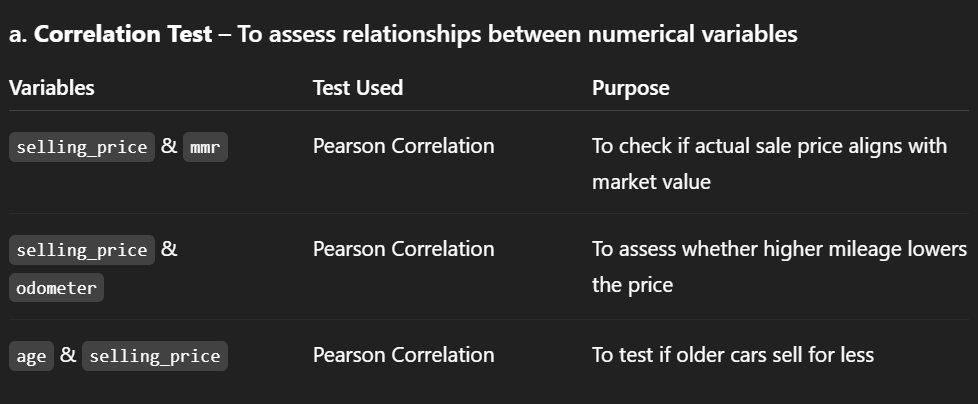

In [69]:
from scipy.stats import pearsonr
import numpy as np
# Select needed columns
filtered_df = car_sales_df[['selling_price', 'mmr', 'odometer', 'age']].copy()

# Replace NaN, inf, and -inf with 0
filtered_df = filtered_df.replace([np.inf, -np.inf], 0).fillna(0)

# Run Pearson correlations
corr_price_mmr, _ = pearsonr(filtered_df['selling_price'], filtered_df['mmr'])
corr_price_odom, _ = pearsonr(filtered_df['selling_price'], filtered_df['odometer'])
corr_price_age, _ = pearsonr(filtered_df['selling_price'], filtered_df['age'])

# Print the results
print(f"📊 Correlation between Selling Price & MMR: {corr_price_mmr:.2f}")
print(f"📊 Correlation between Selling Price & Odometer: {corr_price_odom:.2f}")
print(f"📊 Correlation between Selling Price & Age: {corr_price_age:.2f}")

📊 Correlation between Selling Price & MMR: 0.98
📊 Correlation between Selling Price & Odometer: -0.58
📊 Correlation between Selling Price & Age: -0.59


b. Chi-Square Test – For associations between categorical variables
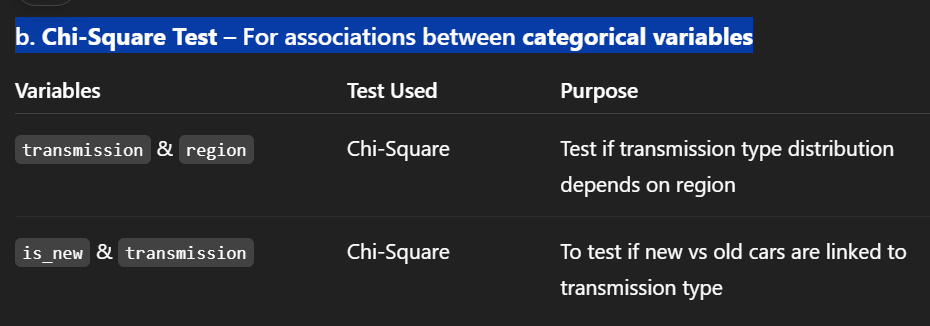

In [71]:
from scipy.stats import chi2_contingency
import pandas as pd

# Example: transmission vs region
contingency = pd.crosstab(car_sales_df['transmission'], car_sales_df['Region'])
chi2, p, dof, expected = chi2_contingency(contingency)

print(f"Chi-square test between transmission and region: p-value = {p:.4f}")

Chi-square test between transmission and region: p-value = 0.0000


**c. T-Test or ANOVA – Comparing mean selling price across groups**
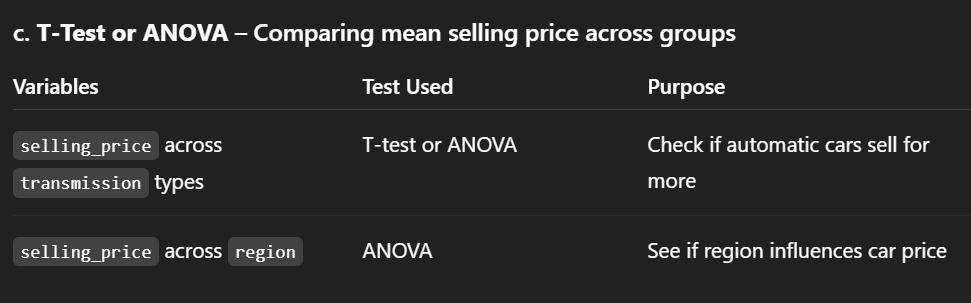

In [83]:
from scipy.stats import ttest_ind

# T-test: automatic vs manual
auto_prices = car_sales_df[car_sales_df['transmission'] == 'automatic']['selling_price']
manual_prices = car_sales_df[car_sales_df['transmission'] == 'manual']['selling_price']
t_stat, p_val = ttest_ind(auto_prices, manual_prices, nan_policy='omit')

print(f"T-test selling price auto vs manual: p-value = {p_val:.4f}")


T-test selling price auto vs manual: p-value = 0.0000


##### Perform one-way ANOVA test

In [92]:
from scipy.stats import f_oneway

# First, you need to define significant_regions - this should be a list of regions you want to compare
# For example, if you want to compare all unique regions in your data:
significant_regions = car_sales_df['Region'].unique()

# Prepare price samples for each region
price_samples = []
for region in significant_regions:
    region_prices = car_sales_df[car_sales_df['Region'] == region]['selling_price'].dropna()
    price_samples.append(region_prices)  # Fixed the typo here (was region_prises)

# Perform one-way ANOVA
f_stat, p_value = f_oneway(*price_samples)

print("\nANOVA Results:")
print(f"F-statistic: {f_stat:.2f}")
print(f"P-value: {p_value:.4f}")

# Interpretation
alpha = 0.05
if p_value < alpha:
    print("\nConclusion: Reject the null hypothesis - There ARE significant price differences between regions.")
else:
    print("\nConclusion: Fail to reject the null hypothesis - No significant price differences between regions.")


ANOVA Results:
F-statistic: 786.51
P-value: 0.0000

Conclusion: Reject the null hypothesis - There ARE significant price differences between regions.


### Interpretation of Results:

Strong positive correlation between selling_price and mmr.

Negative correlation between selling_price and odometer, and also with age.

Chi-square results indicated a statistically significant dependence between transmission and region.

**Correlation Commentary:**

As expected, older cars with higher mileage tended to sell for less.

Cars in good condition maintained better price stability.

Automatic cars dominated high-revenue regions, suggesting a demand preference.



### Recommandation

 **1. Align Pricing Closely with Market Value (MMR)**
Insight: High correlation observed between selling_price and mmr.

Recommendation: Ensure pricing teams use MMR benchmarks to avoid overpricing or underpricing. Integrate MMR tracking into sales systems for better pricing decisions.

**2. Target Buyers Based on Car Age Preferences**
Insight: Car age (age) negatively correlates with selling_price. Newer cars sell for more.

Recommendation: Focus marketing efforts on newer inventory for high-margin sales, while promoting older cars with price-focused campaigns or bulk deals.

**3. Monitor Mileage and Its Effect on Pricing**
Insight: Negative correlation between odometer and selling_price indicates that high mileage reduces value.

Recommendation: Highlight low-mileage cars in listings and consider using mileage brackets (e.g., <20,000 km) in customer filters.

**4. Regional Strategy for Sales and Inventory**
Insight: Some regions have significantly higher revenue and sales volume than others.

Recommendation: Focus inventory and promotional resources on the top-performing 10–15 regions. Underperforming regions may benefit from location-specific promotions or vehicle type adjustments.

 **5. Leverage Condition Score in Marketing**
Insight: Better condition scores likely correlate with higher sale prices.

Recommendation: Promote well-conditioned cars using premium placement in listings.

**6. Support Customer Filtering by Transmission**
Insight: There are differences in selling_price and popularity between automatic and manual transmissions.

Recommendation: Allow users to filter by transmission and highlight trending transmission types in specific regions.

**7. Track Depreciation Trends for Better Buying Decisions**
Insight: Depreciation varies by make, year, and mileage.

Recommendation: Build a depreciation dashboard to help procurement teams identify high-value cars with low depreciation risk.

**8. Promote New Cars Strategically**
Insight: Cars with odometer < 1000 (is_new == 1) sell at premium prices.

Recommendation: Segment and promote these vehicles as “New Arrivals” or “Barely Used” in advertising.



### Other Actionable recommandations
 **1.Inventory Management & Purchasing**
Data Insight: Top 3 brands (Ford, Chevrolet, Nissan) account for 37% of total sales volume.

Actionable Recommendations:

Allocate 50% of procurement budget to Ford, Chevrolet, and Nissan vehicles

Prioritize models with <5% depreciation rate (based on brand-model analysis)

Reduce inventory of brands with >20% depreciation (Daewoo, Plymouth, Oldsmobile) by 30%

**2.Sales & Marketing Optimization**
Data Insight: Automatic transmissions outsell manual 8:1; SUVs dominate in Western regions.

**Digital marketing:**

Google Ads: Bid 20% higher on "automatic transmission" keywords

Facebook: Target SUV ads to Western region audiences aged 30-45

Dealer incentives:

$200 bonus for selling aged inventory (>90 days)

1.5x commission on certified pre-owned sales

**Seasonal promotions:**

"Winter Ready" SUV packages in Northern regions (Oct-Jan)

"Summer Convertible" events in coastal regions (Apr-Jun)

**3. Regional Operations**
Data Insight: California accounts for 28% of premium vehicle sales.

*Inventory distribution:*

Allocate 40% of luxury inventory to California

Shift 15% of pickup inventory to Texas/Oklahoma

Express service centers in high-volume regions

**5. Financial Planning**
Data Insight: Vehicles with <10,000 miles command 22% price premium.

Financing programs:

0.9% APR specials for low-mileage (<15k) certified vehicles

### Conclusion
This exploratory and descriptive analysis of the Car Sales Dataset has provided valuable insights into key factors influencing vehicle pricing and sales performance. By examining patterns in variables such as market value (MMR), mileage, condition, region, transmission type, and age, the analysis has revealed several important relationships that can inform strategic decision-making.

A strong positive correlation was found between the selling price and the market reference price (MMR), confirming that pricing decisions generally align with market expectations. However, factors like mileage and vehicle age negatively impact selling prices, suggesting a depreciation trend that should be accounted for when acquiring and pricing vehicles.

The analysis also revealed regional disparities in sales volume and revenue, indicating that certain regions consistently outperform others. This suggests an opportunity for regional sales optimization through targeted marketing and inventory allocation.

Transmission type and vehicle condition were also shown to influence pricing and buyer preferences. Vehicles in better condition or with preferred transmission types (such as automatic in specific markets) tend to command higher prices.

From these findings, actionable recommendations have been developed to enhance pricing strategy, inventory planning, and customer targeting. These include integrating MMR-based pricing, focusing promotions on high-performing regions, and emphasizing low-mileage, high-condition cars in listings.

Overall, this analysis provides a data-driven foundation for improving operational efficiency, maximizing revenue, and meeting customer expectations more effectively in the car sales market.

